In [1]:
import pandas as pd
from datetime import datetime
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn.cluster import KMeans
from geopy.geocoders import Nominatim, Photon
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
import numpy as np
import ast
import seaborn as sb
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn import preprocessing
from tabulate import tabulate
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, HistGradientBoostingRegressor
from sklearn.tree import DecisionTreeRegressor
from warnings import simplefilter
from matplotlib.ticker import FuncFormatter
import xgboost as xgb
from scipy import stats
from sklearn.preprocessing import MinMaxScaler, StandardScaler
import shap

/home/cdger/.local/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Initial preprocessing
Making sure that the entire dataset is clean and ready to be used.

In [2]:
data = pd.read_excel("Homestays_Data.xlsx")
print(data.columns.values)

['id' 'log_price' 'property_type' 'room_type' 'amenities' 'accommodates'
 'bathrooms' 'bed_type' 'cancellation_policy' 'cleaning_fee' 'city'
 'description' 'first_review' 'host_has_profile_pic'
 'host_identity_verified' 'host_response_rate' 'host_since'
 'instant_bookable' 'last_review' 'latitude' 'longitude' 'name'
 'neighbourhood' 'number_of_reviews' 'review_scores_rating'
 'thumbnail_url' 'zipcode' 'bedrooms' 'beds']


## Ordinal Encoding

In [3]:
def ordinal_encode(col, vals, target_vals):
    d = dict(zip(vals, target_vals))
    for val in vals:
        data.loc[data[col]==val, col] = d[val]

data = data.map(lambda x: 1 if x == True else x)
data = data.map(lambda x: 0 if x == False else x)
ordinal_encode("host_has_profile_pic", ["t","f"], [1,0])
ordinal_encode("host_identity_verified", ["t","f"], [1,0])
ordinal_encode("instant_bookable", ["t","f"], [1,0])
ordinal_encode("cancellation_policy", ['super_strict_60', 'super_strict_30', 'strict', 'moderate', 'flexible'], [4,3,2,1,0])

## Dealing with missing values
Will decide the best course of action for dropping NA values (whether to drop rows or features) after judging each feature's importance in later sections.

In [4]:
print("Number of rows with NaN values: ", data.isna().any(axis=1).sum())
print("Cols vs number of NaN values:\n", tabulate(pd.DataFrame(data.isna().sum()[data.isna().sum()!=0].sort_values(ascending = False), columns=["NaN count"]), headers='keys', tablefmt='psql'))

Number of rows with NaN values:  35615
Cols vs number of NaN values:
 +------------------------+-------------+
|                        |   NaN count |
|------------------------+-------------|
| host_response_rate     |       18299 |
| review_scores_rating   |       16722 |
| first_review           |       15864 |
| last_review            |       15827 |
| thumbnail_url          |        8216 |
| neighbourhood          |        6872 |
| zipcode                |         966 |
| bathrooms              |         200 |
| host_has_profile_pic   |         188 |
| host_identity_verified |         188 |
| host_since             |         188 |
| beds                   |         131 |
| bedrooms               |          91 |
| name                   |          10 |
| description            |           6 |
+------------------------+-------------+


# 1. Feature Engineering:
Task: Enhance the dataset by creating actionable and insightful features. Calculate `Host_Tenure` by
determining the number of years from `host_since` to the current date, providing a measure of host
experience. Generate `Amenities_Count` by counting the items listed in the `amenities` array to quantify
property offerings. Determine `Days_Since_Last_Review` by calculating the days between `last_review`
and today to assess listing activity and relevance.

In [5]:
data["host_since"] = pd.to_datetime(data["host_since"], format='%Y-%m-%d')
data["last_review"] = pd.to_datetime(data["host_since"], format='%Y-%m-%d')
current_date = datetime.now()

data['Host_Tenure'] = (current_date - data["host_since"]).dt.days / 365.25
data["Days_Since_Last_Review"] = (current_date - data["last_review"]).dt.days
data["Days_Since_First_Review"] = (current_date - data["first_review"]).dt.days

def count_elements(string):
    return len(string[1:-1].split(","))
data["Amenities_Count"] = data["amenities"].apply(count_elements)



## Displaying newly engineered features

In [6]:
data[["Host_Tenure", "Amenities_Count", "Days_Since_Last_Review", "Days_Since_First_Review"]]

,Host_Tenure,Amenities_Count,Days_Since_Last_Review,Days_Since_First_Review
0,12.114990,9,4425.0,2880.0
1,6.882957,15,2514.0,2467.0
2,7.531828,19,2751.0,2564.0
3,9.051335,15,3306.0,NaN
4,9.185489,12,3355.0,3283.0
...,...,...,...,...
74106,11.121150,1,4062.0,NaN
74107,8.010951,16,2926.0,2822.0
74108,12.336756,31,4506.0,3412.0
74109,6.636550,15,2424.0,NaN


# 2. Exploratory Data Analysis (EDA):
Task: Conduct a deep dive into the dataset to uncover underlying patterns and relationships. Analyze how
pricing (`log_price`) correlates with both categorical (such as `room_type` and `property_type`) and
numerical features (like `accommodates` and `number_of_reviews`). Utilize statistical tools and
visualizations such as correlation matrices, histograms for distribution analysis, and scatter plots to explore
relationships between variables.

## Getting correlation heatmap

In [7]:
corrtargets = ["log_price", "accommodates", "bathrooms", "cancellation_policy", "cleaning_fee", "host_has_profile_pic", "host_identity_verified", "host_response_rate", "instant_bookable", "number_of_reviews", "bedrooms", "beds", "Host_Tenure", "Days_Since_Last_Review", "Amenities_Count", "Days_Since_First_Review", "review_scores_rating"]

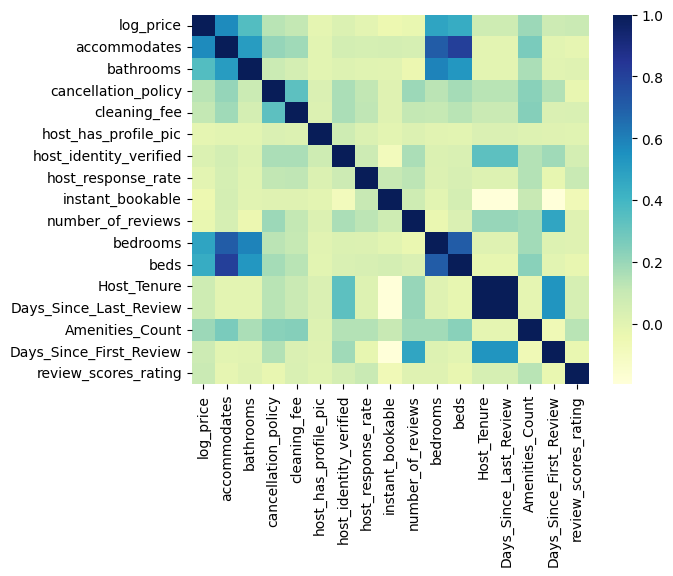

In [8]:
correlation_matrix = data[corrtargets].corr()
corrheatmap = sb.heatmap(pd.DataFrame(correlation_matrix), cmap="YlGnBu") 

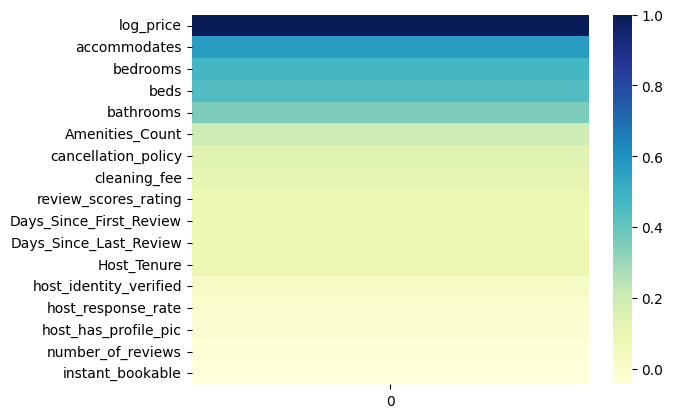

In [9]:
correlation_matrix2 = data[corrtargets].corrwith(data["log_price"])
correlation_matrix2.sort_values(axis = 0, ascending = False, inplace = True)
# print(tabulate(pd.DataFrame(correlation_matrix2, columns=["Correlation with log_price"]), headers='keys', tablefmt='psql'))
corrheatmap2 = sb.heatmap(pd.DataFrame(correlation_matrix2), cmap="YlGnBu") 

## Getting histograms

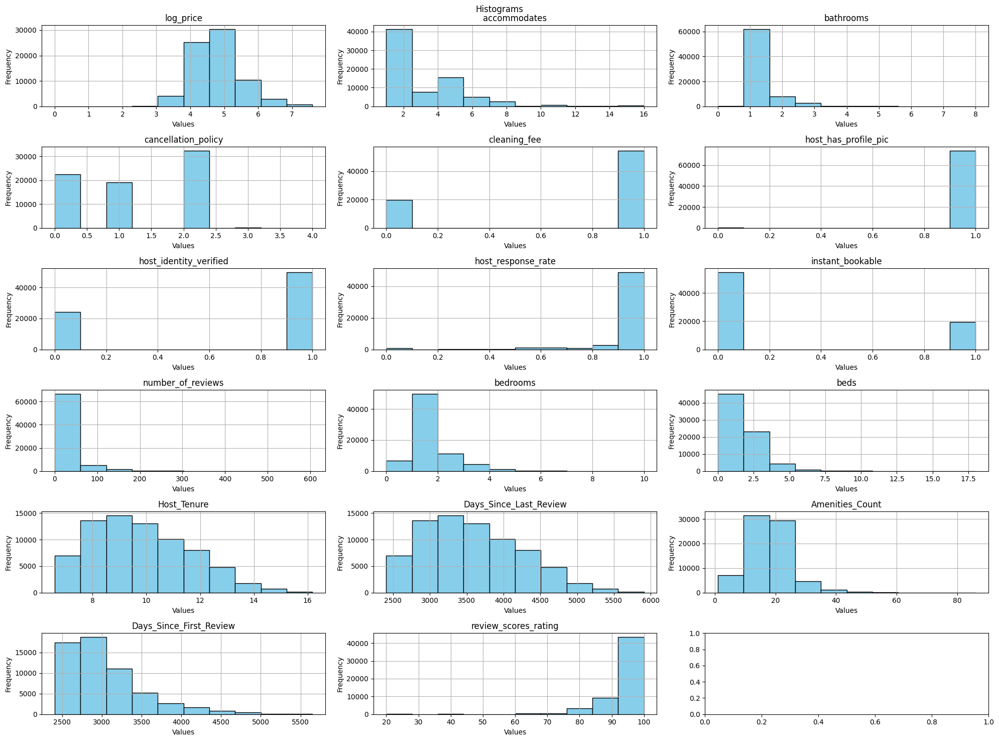

In [10]:
# Histograms
fig, ax = plt.subplots(len(corrtargets)//3 + 1,3, figsize = (20,15))
i = 0
# for col in list(data.columns.values):
for col in corrtargets:
    # Plot the histogram
    try:
        data[col].hist(color='skyblue', edgecolor='black', ax = ax.flatten()[i])
        ax.flatten()[i].set_title(f"{col}")
        ax.flatten()[i].set_xlabel('Values')
        ax.flatten()[i].set_ylabel('Frequency')
        i = i + 1
    except:
        continue

fig.suptitle("Histograms")
plt.tight_layout()

## Getting scatter plots

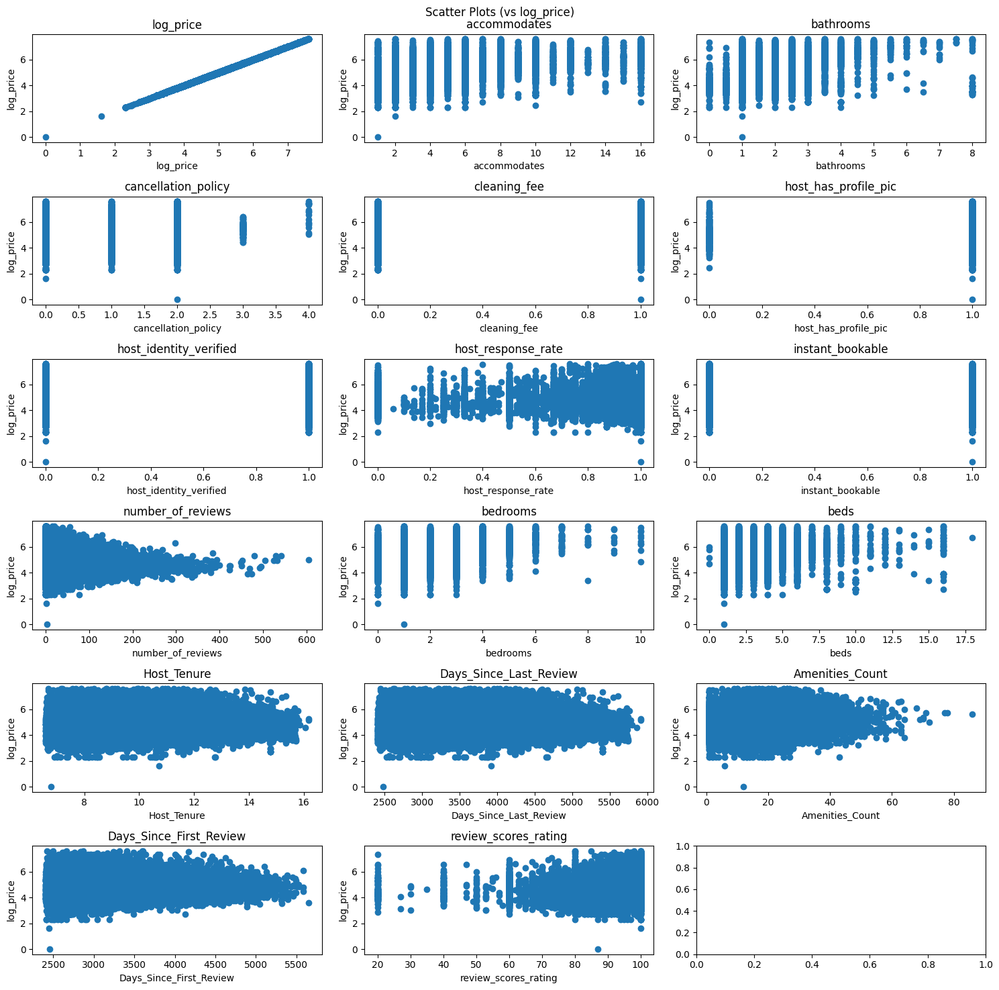

In [11]:
# Scatter plot
fig, ax = plt.subplots(len(corrtargets)//3 + 1,3, figsize = (15,15))
i = 0
for col in corrtargets:
    ax.flatten()[i].scatter(data[col], data["log_price"])
    ax.flatten()[i].set_title(f"{col}")
    ax.flatten()[i].set_xlabel(col)
    ax.flatten()[i].set_ylabel("log_price")
    i = i + 1

fig.suptitle("Scatter Plots (vs log_price)")
plt.tight_layout()

# 3. Geospatial Analysis:
Task: Investigate the geographical data to understand regional pricing trends. Plot listings on a map using
`latitude` and `longitude` data to visually assess price distribution. Examine if certain neighbourhoods or
proximity to city centres influence pricing, providing a spatial perspective to the pricing strategy.

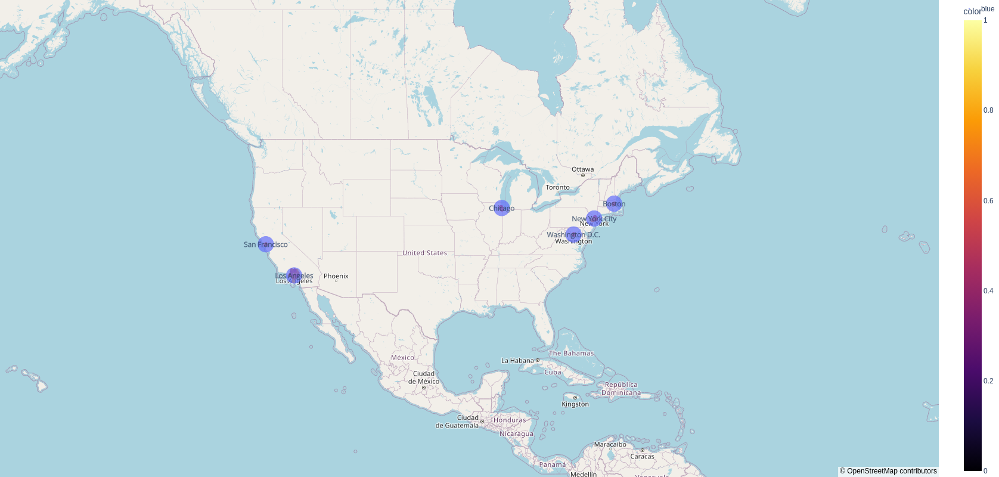

In [12]:
scaler = MinMaxScaler()
fig = px.scatter_mapbox(data, 
                        lat="latitude", 
                        lon="longitude", 
                        hover_name="id", 
                        hover_data=["id", "neighbourhood"],
                        color= scaler.fit_transform(np.array(data["log_price"]).reshape(-1, 1)).flatten(),
                        color_continuous_scale="inferno",
                        # size="Listed",
                        zoom=3, 
                        height=800,
                        width=800)

scatter_data = {
    "lat": [34.052235, 42.360081, 40.712776, 41.878113, 38.907192, 37.774929],
    "lon": [-118.243683, -71.058884, -74.005974, -87.629799, -77.036871, -122.419416],
    "text": ["Los Angeles", "Boston", "New York City", "Chicago", "Washington D.C.", "San Francisco"],
    "size": [1] * 6,  # Size of the markers
    "color": ["blue"] * 6  # Color of the markers
}

fig.add_trace(px.scatter_mapbox(**scatter_data).data[0])

fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

## Neighbourhood price distribution

619 neighbourhoods


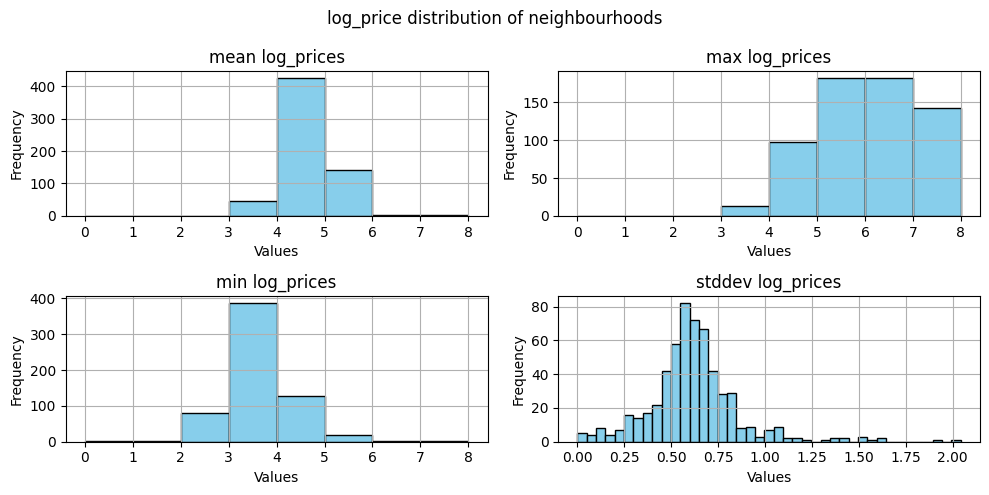

In [13]:
print(len(list(pd.get_dummies(data["neighbourhood"]).columns.values)), "neighbourhoods")

# Calculate stats for log price for each neighbourhood
neighbourhood_prices = pd.DataFrame(columns = ["neighbourhood", "mean log_price", "max log_price", "min log_price", "stddev log_price", "mean latitude", "mean longitude"])
i = 0
for neighbourhood in data["neighbourhood"].unique():
    slice = data[data["neighbourhood"] == neighbourhood]
    neighbourhood_prices.loc[i] = [neighbourhood, slice["log_price"].mean(), slice["log_price"].max(), slice["log_price"].min(), slice["log_price"].std(), slice["latitude"].mean(), slice["longitude"].mean()]
    i = i+1

neighbourhood_prices = neighbourhood_prices.sort_values(by="mean log_price", ascending = False)
tabulate(neighbourhood_prices, headers='keys', tablefmt='psql')

fig, ax = plt.subplots(2,2, figsize = (10,5))

i = 0
for col in list(neighbourhood_prices.columns.values):
    if col[-len("log_price"):] == "log_price":
        if col != "stddev log_price":
            bins = [0,1,2,3,4,5,6,7,8]
        else:
            bins = "auto"
        neighbourhood_prices[col].hist(bins = bins, color='skyblue', edgecolor='black', ax = ax.flatten()[i])
        ax.flatten()[i].set_title(f"{col}s")
        ax.flatten()[i].set_xlabel('Values')
        if col != "stddev log_price":
            ax.flatten()[i].set_xticks(ticks = bins, labels = bins)
        ax.flatten()[i].set_ylabel('Frequency')
        i = i + 1
    
fig.suptitle('log_price distribution of neighbourhoods')
plt.tight_layout()

## Neighbourhood correlation heatmaps

In [14]:
# One hot encoding neighbourhoods
neighbourhood_list = list(pd.get_dummies(data["neighbourhood"]).columns.values)
one_hot = pd.get_dummies(data["neighbourhood"])
# data = data.drop("neighbourhood",axis = 1)
data = pd.concat([data, one_hot], axis = 1)

In [15]:
correlation = data[neighbourhood_list].corrwith(data["log_price"])
correlation = correlation.sort_values(ascending = False)

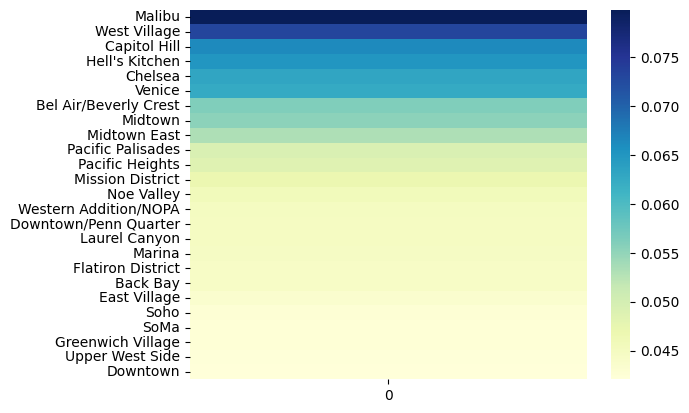

In [16]:
corrheatmap = sb.heatmap(pd.DataFrame(correlation).head(25), cmap="YlGnBu") 

### Neighbourhoods associated with lower prices

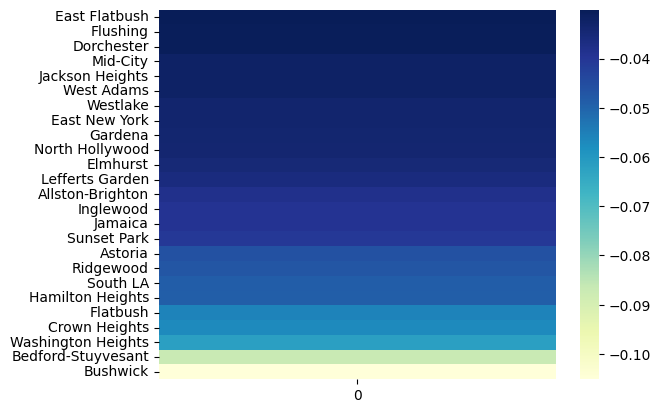

In [17]:
corrheatmap2 = sb.heatmap(pd.DataFrame(correlation).tail(25), cmap="YlGnBu") 

## City price distribution

In [18]:
city_prices = pd.DataFrame(columns = ["city", "mean log_price", "max log_price", "min log_price", "stddev log_price", "mean latitude", "mean longitude"])
i = 0
for city in data["city"].unique():
    dfslice = data[data["city"] == city]
    city_prices.loc[i] = [str(city), dfslice["log_price"].mean(), dfslice["log_price"].max(), dfslice["log_price"].min(), dfslice["log_price"].std(), dfslice["latitude"].mean(), dfslice["longitude"].mean()]
    i = i+1

city_prices.sort_values(by="mean log_price", axis = 0, inplace = True)
city_prices.reset_index(drop=True, inplace = True)

print(tabulate(city_prices, headers='keys', tablefmt='psql'))

+----+---------+------------------+-----------------+-----------------+--------------------+-----------------+------------------+
|    | city    |   mean log_price |   max log_price |   min log_price |   stddev log_price |   mean latitude |   mean longitude |
|----+---------+------------------+-----------------+-----------------+--------------------+-----------------+------------------|
|  0 | Chicago |          4.62008 |         7.31322 |         2.30259 |           0.700238 |         41.9082 |         -87.6644 |
|  1 | NYC     |          4.71934 |         7.6004  |         0       |           0.661567 |         40.7302 |         -73.9549 |
|  2 | LA      |          4.7205  |         7.6004  |         2.30259 |           0.739269 |         34.0565 |        -118.334  |
|  3 | Boston  |          4.88404 |         7.24423 |         2.83321 |           0.664692 |         42.3397 |         -71.0841 |
|  4 | DC      |          4.9868  |         7.6004  |         2.30259 |           0.82116 

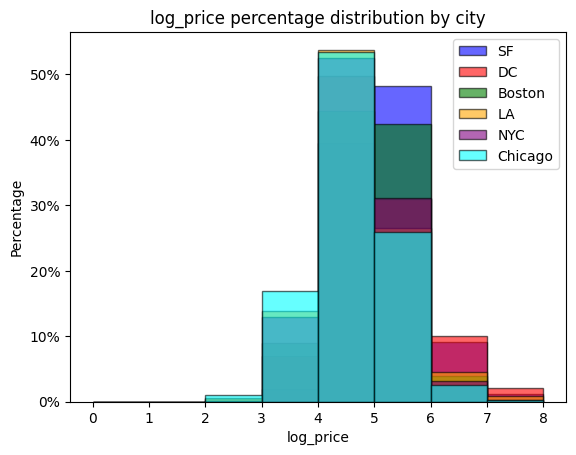

In [19]:
def format_percent(x, pos):
    return '{:.0f}%'.format(x * 100)
formatter = FuncFormatter(format_percent)
colors = ["blue", "red", "green", "orange", "purple", "cyan"]
i = 0
for city in city_prices["city"].sort_index(ascending= False):
    plt.hist(data[data["city"]==city]["log_price"], label=city,edgecolor='black', density=True, alpha=0.6, bins = [0,1,2,3,4,5,6,7,8], color = colors[i])
    plt.xlabel("log_price")
    plt.ylabel("Percentage")
    plt.title("log_price percentage distribution by city")
    i = i + 1
plt.gca().yaxis.set_major_formatter(formatter)
plt.legend(loc='upper right')
plt.show()

In [20]:
# fig, ax = plt.subplots(2,3, figsize = (10,5))

# i = 0
# for city in city_prices["city"]:
#     bins = [0,1,2,3,4,5,6,7,8]
#     data[data["city"]==city]["log_price"].hist(bins=bins, color='skyblue', edgecolor='black', ax = ax.flatten()[i])
#     ax.flatten()[i].set_title(f"{city}")
#     ax.flatten()[i].set_xlabel('Values')
#     ax.flatten()[i].set_ylabel('Frequency')
#     i = i + 1
    
# fig.suptitle('log_price distribution by city')
# plt.tight_layout()


# def get_city(row):
#     coord = f"{row['mean latitude']}, {row['mean longitude']}"
#     location = geolocator.reverse(coord, exactly_one=True)
#     address = location.raw['address']
#     city = address.get('city')
#     row['city'] = city
#     return row
# geolocator = Nominatim(user_agent="getcitynotebook")
# city_prices = city_prices.apply(get_city, axis = 1)
# city_prices

## City correlation heatmaps

In [21]:
# One hot encoding cities
city_list = list(pd.get_dummies(data["city"]).columns.values)
one_hot = pd.get_dummies(data["city"])
# data = data.drop("city",axis = 1)
data = pd.concat([data, one_hot], axis = 1)

In [22]:
correlation = data[city_list].corrwith(data["log_price"])
correlation = correlation.sort_values(ascending = False)

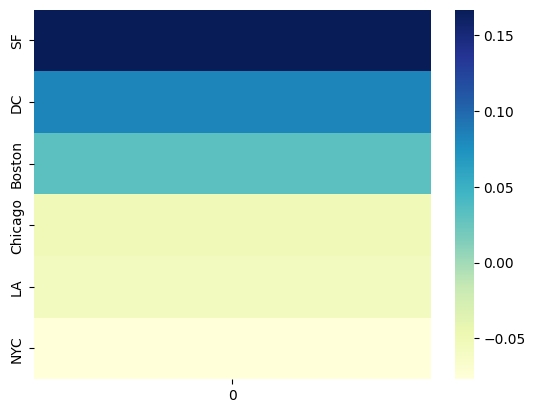

In [23]:
corrheatmap = sb.heatmap(pd.DataFrame(correlation).head(25), cmap="YlGnBu") 

# 4. Sentiment Analysis on Textual Data:
Task: Apply advanced natural language processing techniques to the `description` texts to extract
sentiment scores. Use sentiment analysis tools to determine whether positive or negative descriptions
influence listing prices, incorporating these findings into the predictive model being trained as a feature.

In [24]:
data['description'] = data['description'].replace(np.nan, '', regex=True)

# Initialize VADER sentiment analyzer
analyzer = SentimentIntensityAnalyzer()

def calculate_sentiment(row):
    sentence = row["description"]
    # Analyze sentiment
    sentiment_score = analyzer.polarity_scores(sentence)

    # Interpret sentiment score
    if sentiment_score['compound'] >= 0.05:
        row["sentiment"] = 1 # Positive
    elif sentiment_score['compound'] <= -0.05:
        row["sentiment"] = -1 # Negative
    else:
        row["sentiment"] = 0 # Neutral
    return row

data["sentiment"] = np.nan
data = data.apply(calculate_sentiment, axis = 1)


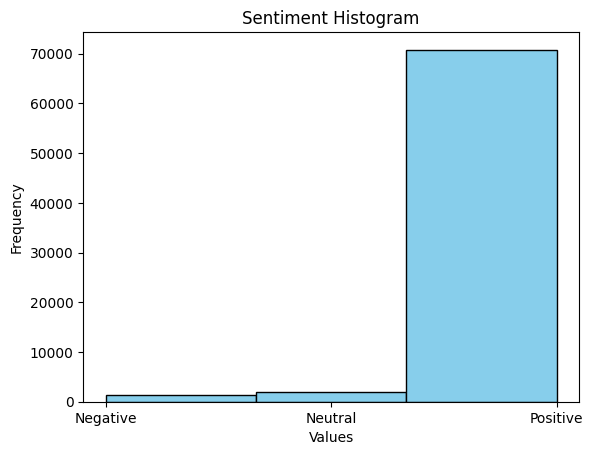

In [25]:
plt.hist(data["sentiment"], bins=3, color='skyblue', edgecolor='black')
plt.title(f"Sentiment Histogram")
plt.xticks(ticks = [-1,0,1], labels = ["Negative","Neutral","Positive"])
plt.xlabel('Values')
plt.ylabel('Frequency')
plt.show()

# 5. Amenities Analysis:
Task: Thoroughly parse and analyse the `amenities` provided in the listings. Identify which amenities are
most associated with higher or lower prices by applying statistical tests to determine correlations, thereby
informing both pricing strategy and model inputs.

## One-hot encoding amenities

In [26]:
simplefilter(action="ignore", category=pd.errors.PerformanceWarning)

# Creating list of all amenities
amenity_list = list()
for index, row in data.iterrows():
    amenities = row["amenities"][1:-1].split(",")
    amenities = [a.strip('\"') for a in amenities]   
    for amenity in amenities:
        if amenity not in amenity_list:
            amenity_list.append(amenity)

data[amenity_list] = 0

# One hot encoding amenities
def onehotencode_amenities(row):
    amenities = row["amenities"][1:-1].split(",")
    amenities = [a.strip('\"') for a in amenities]
    for amenity in amenities:
        row[amenity] = 1
    return row

data = data.apply(onehotencode_amenities, axis = 1)

In [27]:
correlation = data[amenity_list].corrwith(data["log_price"])
correlation = correlation.sort_values(ascending = False)

## Correlation heatmap of amenities with increasing log_price

<Axes: >

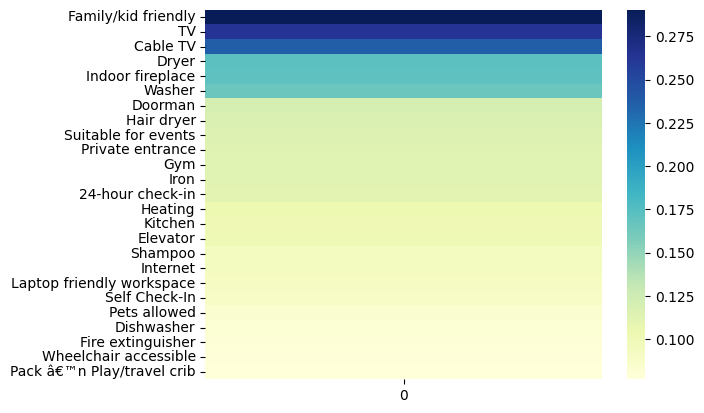

In [28]:
corrheatmap = sb.heatmap(pd.DataFrame(correlation).head(25), cmap="YlGnBu") 
corrheatmap

## Correlation heatmap of amenities with reducing log_price

<Axes: >

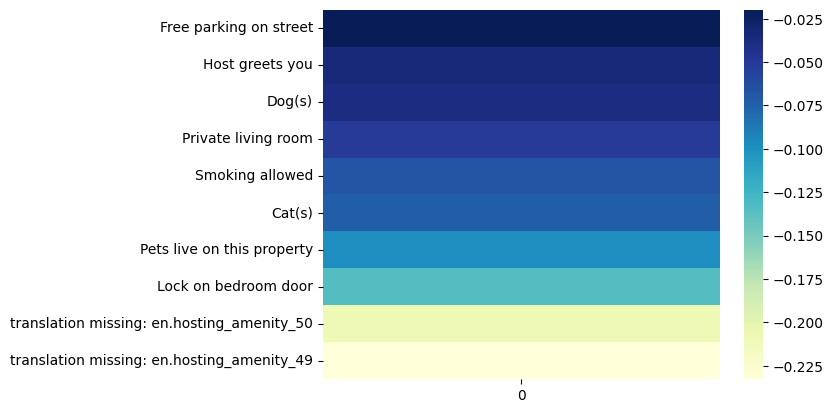

In [29]:
corrheatmap = sb.heatmap(pd.DataFrame(correlation).tail(10), cmap="YlGnBu") 
corrheatmap

In [30]:
# print(correlation.shape)
# with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
#     print(correlation)

# 6. Categorical Data Encoding:
Task: Convert categorical data into a format suitable for machine learning analysis. Apply one-hot encoding
to variables like `room_type`, `city`, and `property_type`, ensuring that the model can interpret these as
distinct features without any ordinal implication

In [31]:
categorical_cols = ["room_type", "property_type", "bed_type"]
for col in categorical_cols:
    one_hot = pd.get_dummies(data[col])
    data = data.drop(col,axis = 1)
    data = pd.concat([data, one_hot], axis = 1)

# 7. Model Development and Training:
Task: Design and train predictive models to estimate `log_price`. Begin with a simple linear regression to
establish a baseline, then explore more complex models such as RandomForest and GradientBoosting to
better capture non-linear relationships and interactions between features. Document (briefly within
Jupyter notebook itself) the model-building process, specifying the choice of algorithms and rationale.

In [32]:
"""
Y:
log_price
X:
accommodates
bathrooms
bed_type
cancellation_policy - Ordinal encode
cleaning_fee - Convert TRUE FALSE to 1 0
description - Consider sentiment
first_review - Dont consider
host_has_profile_pic - Convert t f to 1 0
host_response_rate
host_identity_verified - Convert t f to 1 0
host_since -  Dont consider
instant_bookable - Convert t f to 1 0
last_review - Dont consider
latitude - Dont consider
longitude - Dont consider
name - Dont consider
neighbourhood
number_of_reviews
review_scores_rating
zipcode - Dont consider
bedrooms
beds
Host Tenure
Days Since Last Review
Amenities Count
City onehot
Property type onehot
Room type onehot
"""

'\nY:\nlog_price\nX:\naccommodates\nbathrooms\nbed_type\ncancellation_policy - Ordinal encode\ncleaning_fee - Convert TRUE FALSE to 1 0\ndescription - Consider sentiment\nfirst_review - Dont consider\nhost_has_profile_pic - Convert t f to 1 0\nhost_response_rate\nhost_identity_verified - Convert t f to 1 0\nhost_since -  Dont consider\ninstant_bookable - Convert t f to 1 0\nlast_review - Dont consider\nlatitude - Dont consider\nlongitude - Dont consider\nname - Dont consider\nneighbourhood\nnumber_of_reviews\nreview_scores_rating\nzipcode - Dont consider\nbedrooms\nbeds\nHost Tenure\nDays Since Last Review\nAmenities Count\nCity onehot\nProperty type onehot\nRoom type onehot\n'

## Further preprocessing

In [33]:
# Dropping columns that dont relate with Y directly or have been processed to different columns
data.drop(["amenities", "description", "first_review", "host_since", "last_review", "latitude", "longitude", "name", "zipcode", "thumbnail_url", "neighbourhood", "city", "Other"], axis = 1, inplace = True)
print(list(data.columns.values))

['id', 'log_price', 'accommodates', 'bathrooms', 'cancellation_policy', 'cleaning_fee', 'host_has_profile_pic', 'host_identity_verified', 'host_response_rate', 'instant_bookable', 'number_of_reviews', 'review_scores_rating', 'bedrooms', 'beds', 'Host_Tenure', 'Days_Since_Last_Review', 'Days_Since_First_Review', 'Amenities_Count', '16th Street Heights', 'Adams Morgan', 'Alamo Square', 'Albany Park', 'Alhambra', 'Allerton', 'Allston-Brighton', 'Alondra Park', 'Alphabet City', 'Altadena', 'American University Park', 'Anacostia', 'Andersonville', 'Annadale', 'Arboretum', 'Arcadia', 'Archer Heights', 'Arleta', 'Armour Square', 'Arrochar', 'Artesia', 'Arts District', 'Ashburn', 'Astoria', 'Atwater Village', 'Auburn Gresham', 'Austin', 'Avondale', 'Azusa', 'Back Bay', 'Back of the Yards', 'Balboa Terrace', 'Baldwin Hills', 'Baldwin Park', 'Barney Circle', 'Barry Farm', 'Bath Beach', 'Battery Park City', 'Bay Ridge', 'Baychester', 'Bayside', 'Bayview', 'Beacon Hill', 'Bedford Park', 'Bedford-S

## Dropping less important features
The features have a very low correlation coefficient, along with a large number of NA values. Therefore, it is better to drop them. Each of these features had more than 15,000 NA values altogether covering 26,325 rows.

In [34]:
print("Number of rows with NaN values before dropping features: ", data.isna().any(axis=1).sum())
data.drop(["Days_Since_Last_Review", "Days_Since_First_Review", "host_response_rate", "review_scores_rating"], axis = 1, inplace = True)
print("Number of rows with NaN values after dropping features: ", data.isna().any(axis=1).sum())
# Dropping rest of rows with NA values - 
data.dropna(inplace = True)

Number of rows with NaN values before dropping features:  26325
Number of rows with NaN values after dropping features:  532


## Splitting dataset

In [35]:
# Split the data into X (features) and y (target)
X = data.drop('log_price', axis=1)

# Scaled X
scaler = MinMaxScaler()
scaled_X = scaler.fit_transform(X)

y = data['log_price']

# Split the data into training and testing sets
scaled_X_train, scaled_X_test, scaled_y_train, scaled_y_test = train_test_split(scaled_X,y,test_size=0.2, random_state=42)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [36]:
def compute_metric(predictions, y):
    # Calculate Mean Absolute Error (MAE)
    mae = mean_absolute_error(y, predictions)
    
    # Calculate Mean Squared Error (MSE)
    mse = mean_squared_error(y, predictions)
    
    # Calculate R-squared
    r_squared = r2_score(y, predictions)
    
    print("Mean Absolute Error:", mae)
    print("Mean Squared Error:", mse)
    print("R-squared:", r_squared)

## Linear Regression
Just testing to see baseline performance level.

In [37]:
model = LinearRegression()
model.fit(X_train, y_train)

LinearRegression()

In [38]:
print("Train metric")
compute_metric(model.predict(X_train), y_train)

print("Test metric")
compute_metric(model.predict(X_test), y_test)

Train metric
Mean Absolute Error: 0.2978154712162191
Mean Squared Error: 0.16726204215102553
R-squared: 0.6765373790884435
Test metric
Mean Absolute Error: 0.30547141332333155
Mean Squared Error: 0.17765838604519238
R-squared: 0.6507659125092686


## Decision Tree Regressor
Here we observe that the model overfits greatly. Therefore, it is better to use a decision tree ensemble, which can explore more possible trees. 

In [39]:
drtree = DecisionTreeRegressor()
drtree.fit(X_train, y_train)


DecisionTreeRegressor()

In [40]:
print("Train metric")
compute_metric(drtree.predict(X_train), y_train)

print("Test metric")
compute_metric(drtree.predict(X_test), y_test)

Train metric
Mean Absolute Error: 2.1954361834491652e-18
Mean Squared Error: 1.645051664303199e-33
R-squared: 1.0
Test metric
Mean Absolute Error: 0.422165821003743
Mean Squared Error: 0.33473265466083046
R-squared: 0.3419952989211078


## Random Forests Regressor
After trying this decision tree ensemble, we observe that overfitting is reduced albeit still there. I tried increasing the number of estimators to reduce overfitting. However, performance stagnated at this metric.

In [ ]:
random_forest = RandomForestRegressor(n_estimators = 1000)
random_forest.fit(X_train, y_train)

In [ ]:
print("Train metric")
compute_metric(random_forest.predict(X_train), y_train)

print("Test metric")
compute_metric(random_forest.predict(X_test), y_test)

## Gradient Boosted Regressor

In [ ]:
gradientboosted = GradientBoostingRegressor(n_estimators=1000, random_state=42, max_depth = 7)
gradientboosted.fit(X_train, y_train)

In [ ]:
print("Train metric")
compute_metric(gradientboosted.predict(X_train), y_train)

print("Test metric")
compute_metric(gradientboosted.predict(X_test), y_test)

## Histogram Gradient Boosted Regressor

In [ ]:
histgradientboosted = HistGradientBoostingRegressor(random_state=42)
histgradientboosted.fit(X_train, y_train)

In [ ]:
print("Train metric")
compute_metric(histgradientboosted.predict(X_train), y_train)

print("Test metric")
compute_metric(histgradientboosted.predict(X_test), y_test)

## XGBoosted Decision Tree Regressor

In [ ]:
# Define XGBoost model parameters
params = {
    'objective': 'reg:squarederror',  # Use squared error for regression task
    'max_depth': 7,                    # Maximum depth of each tree
    'learning_rate': 0.1,              # Learning rate (eta) for boosting
    'n_estimators': 5000               # Number of boosting rounds (trees)
}

# Initialize XGBoost regressor
xgb_regressor = xgb.XGBRegressor(**params)

# Train the model on the training data
xgb_regressor.fit(X_train, y_train)

In [ ]:
print("Train metric")
compute_metric(xgb_regressor.predict(X_train), y_train)

print("Test metric")
compute_metric(xgb_regressor.predict(X_test), y_test)

## Gradient Boosted Random Forests Regressor

In [ ]:
# Train a Random Forest Regressor
rf_reg = RandomForestRegressor(n_estimators=1000, random_state=42)
rf_reg.fit(X_train, y_train)

# Train a Gradient Boosting Regressor
gb_reg = GradientBoostingRegressor(n_estimators=1000, random_state=42, max_depth = 15)
gb_reg.fit(X_train, y_train)

In [ ]:
rf_pred = rf_reg.predict(X_train)
gb_pred = gb_reg.predict(X_train)
combined_pred_reg = (rf_pred + gb_pred) / 2

rf_pred_test = rf_reg.predict(X_test)
gb_pred_test = gb_reg.predict(X_test)
combined_pred_reg_test = (rf_pred_test + gb_pred_test) / 2

In [ ]:
print("Train metric")
compute_metric(combined_pred_reg, y_train)
print("Test metric")
compute_metric(combined_pred_reg_test, y_test)

# 8. Model Optimization and Validation:
Task: Systematically optimize the models to achieve the best performance. Employ techniques like grid
search to experiment with different hyperparameters settings. Validate model choices through techniques
like k-fold cross-validation, ensuring the model generalizes well to unseen data.

# 9. Feature Importance and Model Insights:
Task: Analyze the trained models to identify which features most significantly impact `log_price`. Utilize
model-specific methods like feature importance scores for tree-based models and SHAP values for an in-
depth understanding of feature contributions.

## Random Forest Feature Importances

In [ ]:
feature_importances = random_forest.feature_importances_
feature_names = X_train.columns 

In [ ]:
def show_feature_importances(feature_importances, groupsize = 30, grouplimit = 3):
    for i in range(0, (len(feature_importances)//groupsize) -1):
        if i>=grouplimit:
            break
        # Sort feature importances in descending order
        sorted_indices = feature_importances.argsort()[::-1]
        sorted_feature_importances = feature_importances[sorted_indices][i*groupsize:(i+1)*groupsize]
        sorted_feature_names = feature_names[sorted_indices][i*groupsize:(i+1)*groupsize]
        
        # Plot feature importances
        plt.figure(figsize=(10, 6))
        plt.bar(range(groupsize), sorted_feature_importances, tick_label=sorted_feature_names)
        plt.title("Feature Importances")
        plt.xlabel("Features")
        plt.ylabel("Importance Score")
        plt.xticks(rotation=90)
        plt.show()

    return sorted_feature_names, sorted_feature_importances

sorted_feature_names, sorted_feature_importances = show_feature_importances(random_forest.feature_importances_)

## SHAP Feature Importances

In [ ]:
# Create a SHAP explainer object
linear_regression_explainer = shap.Explainer(model, scaled_X_train)
# Compute SHAP values
linear_regression_shap_values = explainer.shap_values(X_train)

random_forests_explained = shap.Explainer(randomforests, X_train)
random_forests_shap_values = explainer.shap_values(X_train, approximate = True)
# You can also use specific methods for tree-based models like below:
# shap_values = explainer.shap_values(X_train, approximate=True)



In [ ]:
# Visualize the SHAP values (optional)
shap.summary_plot(linear_regression_shap_values, scaled_X_train)

In [ ]:
shap.summary_plot(random_forests_shap_values, X_train)

# 10. Predictive Performance Assessment:
Task: Critically evaluate the performance of the final model on a reserved test set. Use metrics such as
Root Mean Squared Error (RMSE) and R-squared to assess accuracy and goodness of fit. Provide a detailed
analysis of the residuals to check for any patterns that might suggest model biases or misfit.